In [1]:
#import pachkages to connect with Google Sheets and postgres database
# %pip install gspread
# %pip install gspread-dataframe
# %pip install sqlalchemy
# %pip install psycopg2
# %pip install pandas-profiling
# %pip install oauth2client
# %pip install sktime
import gspread 
from gspread_dataframe import set_with_dataframe
from sqlalchemy import create_engine
import pandas as pd
import json
import gspread
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
from oauth2client.service_account import ServiceAccountCredentials
from pandas_profiling import ProfileReport
from sklearn.ensemble import ExtraTreesClassifier, RandomForestClassifier
from sklearn.metrics import (accuracy_score, log_loss, make_scorer,
                             roc_auc_score)
from sklearn.model_selection import (GridSearchCV, KFold, ParameterGrid,
                                     ParameterSampler, RandomizedSearchCV,
                                     StratifiedKFold, StratifiedShuffleSplit,
                                     cross_val_score, train_test_split)
from sklearn.pipeline import Pipeline
from sklearn.utils import resample
from datetime import datetime, timedelta
from sktime.forecasting.arima import ARIMA,AutoARIMA
from sktime.forecasting.sarimax import SARIMAX
from sktime.forecasting.naive import NaiveForecaster
from sktime.forecasting.var import VAR
from sktime.forecasting.ets import AutoETS
from sktime.forecasting.fbprophet import Prophet
from datetime import datetime, timedelta
from sktime.forecasting.compose import TransformedTargetForecaster
from sktime.transformations.series.detrend import Deseasonalizer, Detrender
from sktime.forecasting.trend import PolynomialTrendForecaster
from sktime.forecasting.base import ForecastingHorizon
from sktime.forecasting.compose import make_reduction,MultioutputTimeSeriesRegressionForecaster,DirectTabularRegressionForecaster,MultioutputTabularRegressionForecaster
from sklearn.linear_model import LinearRegression
from sktime.forecasting.model_selection import temporal_train_test_split, SingleWindowSplitter,SlidingWindowSplitter
from statsmodels.tsa.stattools import adfuller
from termcolor import colored
from sktime.forecasting.model_selection import ForecastingRandomizedSearchCV
from sklearn.base import BaseEstimator, RegressorMixin, TransformerMixin, ClassifierMixin

/home/sourish/.local/lib/python3.10/site-packages/numba/core/decorators.py:262: NumbaDeprecationWarning: numba.generated_jit is deprecated. Please see the documentation at: https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-generated-jit for more information and advice on a suitable replacement.
  warnings.warn(msg, NumbaDeprecationWarning)
/home/sourish/.local/lib/python3.10/site-packages/visions/backends/shared/nan_handling.py:51: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def hasna(x: np.ndarray) -> bool:
/tmp/ipykernel_66466/1192441809.py:19: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use

## Raw data fetch

In [3]:
#1) sales data

sales_data = []
with open('sales_data_nexasun.json', 'r') as file:
    for line in file:
        sales_data.append(json.loads(line))
# sales_data

# convert json to pandas dataframe and convert date column to meaningful datetime format
sales_df = pd.DataFrame(sales_data)
sales_df.head()


,order_id,date,time,variant_id,price,discount,sales_quantity
0,2113134,1602028800000,1602087445157,41429400879255,19.95,0.00,2
1,5529610,1602028800000,1602086318042,41429400879255,19.95,0.00,1
2,8606644,1602028800000,1602087445157,41429400879255,19.95,0.00,2
3,8725946,1602028800000,1602086318042,41429400879255,19.95,0.00,1
4,5222144,1602115200000,1602175099124,41429400879255,19.95,0.08,1


#### Fetching data from the postgres database



In [4]:
import psycopg2
# Connect to the postgres DB and fetch the data
# connection details for postgres database:
schema_name = "google_ads"
table_name_marketing_campaign_spends = "campaign_spend"
table_name_marketing_campaign_performance = "campaign_performance"
user = "jobs_ro"
password = "ilovecaseslol"  # the password was provide wrong as " ilovecaseslol"
host = "voids-jobs.c2wwnfcaisej.eu-central-1.rds.amazonaws.com"
database = "postgres"

conn = psycopg2.connect(user=user, password=password, host=host, database=database, port=5432)
cursor = conn.cursor()

In [5]:
# 2) campaign_performance
cursor.execute("SELECT * FROM google_ads.campaign_performance")
campaign_performance = cursor.fetchall()
campaign_performance

[('2022-06-28 00:00:00', 6401833, 40570570768535, 11210),
 ('2022-07-01 00:00:00', 6401833, 40570570768535, 7287),
 ('2022-07-05 00:00:00', 6401833, 40570570768535, 20392),
 ('2022-07-06 00:00:00', 6401833, 40570570768535, 60247),
 ('2022-07-07 00:00:00', 6401833, 40570570768535, 75973),
 ('2022-07-08 00:00:00', 6401833, 40570570768535, 62015),
 ('2022-07-09 00:00:00', 6401833, 40570570768535, 57207),
 ('2022-07-10 00:00:00', 6401833, 40570570768535, 7816),
 ('2022-07-11 00:00:00', 6401833, 40570570768535, 40875),
 ('2022-07-12 00:00:00', 6401833, 40570570768535, 37912),
 ('2022-07-13 00:00:00', 4103075, 40570570768535, 65156),
 ('2022-07-14 00:00:00', 4103075, 40570570768535, 25174),
 ('2022-07-15 00:00:00', 4103075, 40570570768535, 48395),
 ('2022-07-16 00:00:00', 4103075, 40570570768535, 835845),
 ('2022-07-17 00:00:00', 4103075, 40570570768535, 129884),
 ('2022-07-18 00:00:00', 4103075, 40570570768535, 231980),
 ('2022-07-19 00:00:00', 4103075, 40570570768535, 59311),
 ('2022-07-20

In [6]:
#- 3) campaign_spend

conn = psycopg2.connect(user=user, password=password, host=host, database=database, port=5432)
cursor = conn.cursor()
cursor.execute("SELECT * FROM google_ads.campaign_spend")
campaign_spend = cursor.fetchall()
campaign_spend

[('2022-06-28 00:00:00', 6401833, 73.0, 40570570768535),
 ('2022-07-01 00:00:00', 6401833, 47.0, 40570570768535),
 ('2022-07-05 00:00:00', 6401833, 61.0, 40570570768535),
 ('2022-07-06 00:00:00', 6401833, 224.0, 40570570768535),
 ('2022-07-07 00:00:00', 6401833, 194.0, 40570570768535),
 ('2022-07-08 00:00:00', 6401833, 604.4956, 40570570768535),
 ('2022-07-09 00:00:00', 6401833, 60.0, 40570570768535),
 ('2022-07-10 00:00:00', 6401833, 64.0, 40570570768535),
 ('2022-07-11 00:00:00', 6401833, 388.0, 40570570768535),
 ('2022-07-12 00:00:00', 6401833, 367.0, 40570570768535),
 ('2022-07-13 00:00:00', 4103075, 467.0, 40570570768535),
 ('2022-07-14 00:00:00', 4103075, 175.0, 40570570768535),
 ('2022-07-15 00:00:00', 4103075, 290.0, 40570570768535),
 ('2022-07-16 00:00:00', 4103075, 477.0, 40570570768535),
 ('2022-07-17 00:00:00', 4103075, 488.0, 40570570768535),
 ('2022-07-18 00:00:00', 4103075, 410.0, 40570570768535),
 ('2022-07-19 00:00:00', 4103075, 521.0, 40570570768535),
 ('2022-07-20 00

### 4) google sheets data fetch

In [7]:
#based on credentials for service account, connect to following google sheets

def connect_to_google_sheets():
    # use creds to create a client to interact with the Google Drive API
    scope = ['https://www.googleapis.com/auth/drive.file','https://www.googleapis.com/auth/spreadsheets','https://www.googleapis.com/auth/drive',\
             'https://www.googleapis.com/auth/drive.appdata','https://www.googleapis.com/auth/drive.apps.readonly','https://www.googleapis.com/auth/drive.metadata.readonly',\
            'https://www.googleapis.com/auth/spreadsheets.readonly']
    creds = ServiceAccountCredentials.from_json_keyfile_name('jobs-398713-d8caacaf8ab0.json', scope)
    client = gspread.authorize(creds)
    return client

client = connect_to_google_sheets()

#read the data from the following url location:
url = 'https://docs.google.com/spreadsheets/d/1rU5pdSMJ3UAIwXHzuxBgwYvgn-o9nkosw7TGhfg_Bhw/edit?usp=sharing'
sheet = client.open_by_url(url)
worksheet = sheet.get_worksheet(0)
data = worksheet.get_all_values()
headers = data.pop(0)
df = pd.DataFrame(data, columns=headers)
df.head()

,variant_id,variant_title,color,design,weight,lens_material,frame_material,uv_protection,current_inventory,lead_time,cost_of_goods_sold,rrp
0,31227200549344,SolarWave Aviators,Gold,Classic Aviator,28,Polycarbonate,Metal,UV400,64,30,7.86,49.95
1,41429400879255,AquaVue Wayfarers,Matte Black,Retro Square,32,Glass,Acetate,UV400,28992,30,4.53,19.95
2,40570570768535,Zenith Polar Pros,Tortoise,Oversized Round,30,Polarized,Acetate,UV400,1695,90,18.89,24.95


### 5) Additional data fetch- brent daily price

In [8]:
#read data from this url location:
url = 'https://raw.githubusercontent.com/datasets/oil-prices/main/data/brent-daily.csv'
df_oil_price = pd.read_csv(url,on_bad_lines='skip')
df_oil_price.tail()


,Date,Price
9215,2023-09-12,93.58
9216,2023-09-13,93.04
9217,2023-09-14,95.20
9218,2023-09-15,95.55
9219,2023-09-18,95.95


#### 1) Is it possible to apply an ETL approach to some of the sources, already getting some of the raw data transformation done before loading in the data?


- All the data is already in a structured format and in daily level except for sales_df
- The time series clean dataframe needs to be in daily level, so we need to apply transformation on sales_df to get the daily level aggregated data.for this case it's a static data.However if it was a streaming data we could have used spark streaming to get the daily level aggregated data.

#### 2) Can you find out what all the features stand for and identify the keys?
- campaign_performance contains "marketing_spend"(73.0) in daily-variant_id level for each campaign, as follows:
    {'2022-06-28 00:00:00', 6401833, 73.0, 40570570768535}
- campaign_performance contains "impressions"(11210) in daily-variant_id level for each campaign, as follows:
    {'2022-06-28 00:00:00', 6401833, 40570570768535, 11210}   
- sales_data_nexasun contains sales in transaction(timestamp) level for each variant_id
- data at docs.google.com/spreadsheets contains the variant_id and the corresponding product name, features, cost and distribution information
To prepare the daily time series The keys are "date", "variant_id" ,"campaign_id"

#### 3) What additional data source did you choose and why?

- The daily oil-price brent data is chosen as an additional data source to see the impact of oil price(being one of the most significant macroeconomic indicators) on the overall consumer demand and hence the sales.


## Task #2: Data Processing & Feature engineering (45 min)

In [9]:
sales_df['date'] = pd.to_datetime(sales_df['date'],unit='ms')
sales_df['date'] = sales_df['date'].dt.date
sales_df.tail()
# sales_df['date'] = pd.to_datetime(sales_df['date'].dt.date, format='%Y-%m-%d')
# sales_df.groupby(['date','variant_id']).agg({'sales_quantity':'sum','price':'mean','discount':'mean'}).reset_index()

,order_id,date,time,variant_id,price,discount,sales_quantity
7073,3458501,2022-09-30,1664545112129,41429400879255,19.95,0.0,12
7074,2165745,2022-09-30,1664546397033,41429400879255,19.95,0.0,16
7075,5065022,2022-09-30,1664535337634,41429400879255,19.95,0.0,12
7076,4733025,2022-09-30,1664545112129,41429400879255,19.95,0.0,12
7077,1774300,2022-09-30,1664546397033,41429400879255,19.95,0.0,15


In [10]:
#write a function to get the daily,variant_id level aggregated data from sales_df with columns: date, sales_quantity, selling_price,variant_id,avg_discount
def aggregate_daily_sales(sales_df):
    #convert date to meaningful dateformat
    sales_df['date'] = pd.to_datetime(sales_df['date'])
    sales_df['date'] = pd.to_datetime(sales_df['date'].dt.date, format='%Y-%m-%d')
    daily_sales = sales_df.groupby(['date','variant_id']).agg({'sales_quantity':'sum','price':'mean','discount':'mean'}).reset_index()
    daily_sales = daily_sales.rename(columns={'price':'selling_price','discount':'avg_discount'})
    #if missing value replac with previoius value for same variant_id
    daily_sales = daily_sales.fillna(method='ffill')
    return daily_sales
    

print(sales_df.shape)
daily_sales = aggregate_daily_sales(sales_df)
print(daily_sales.shape)
daily_sales.head()

(7078, 7)
(1583, 5)


,date,variant_id,sales_quantity,selling_price,avg_discount
0,2020-10-07,41429400879255,6,19.95,0.000000
1,2020-10-08,41429400879255,4,19.95,0.090000
2,2020-10-09,41429400879255,4,19.95,0.020000
3,2020-10-10,41429400879255,2,19.95,0.060000
4,2020-10-19,41429400879255,16,19.95,0.053333


In [11]:
campaign_performance = pd.DataFrame(campaign_performance)
campaign_performance.columns = ['date','campaign_id','variant_id','impressions']
campaign_performance['date'] = pd.to_datetime(campaign_performance['date'],format='%Y-%m-%d')
print(campaign_performance['date'].max(),campaign_performance['date'].min())
campaign_performance.shape

2022-10-25 00:00:00 2022-06-28 00:00:00


(255, 4)

In [12]:
campaign_spend =  pd.DataFrame(campaign_spend)
campaign_spend.columns = ['date','campaign_id','spend','variant_id'] 
campaign_spend['date'] = pd.to_datetime(campaign_spend['date'],format='%Y-%m-%d')

#maximum and minimum date in campaign_spend
print(campaign_spend['date'].max(),campaign_spend['date'].min())
campaign_spend.shape

2022-10-25 00:00:00 2022-06-28 00:00:00


(255, 4)

#### as the campaign data from 2022-06-28 - 2022-10-25, it  make sense to use the sales data from 2022-06-28 onwards for the analysis to capture the impact of the campaign on sales.

In [13]:
#prepare the campaign_performance and campaign_spend dataframes and join with daily_sales dataframe

#prepare campaign_performance dataframe with naming columns: date, campaign_id(drop it), variant_id, impressions
#prepare campaign_spend dataframe with columns: date, campaign_id(drop it), spend variant_id
#join these 2 dataframes with daily_sales dataframe on date and variant_id

def daily_level_aggregation(campaign_performance,campaign_spend,daily_sales):
    #name the columns in campaign_performance and campaign_spend dataframes
    campaign_performance = pd.DataFrame(campaign_performance)
    campaign_performance.columns = ['date','campaign_id','variant_id','impressions']
    #format date column in campaign_performance and campaign_spend dataframes to meaningful datetime format
    # campaign_performance = campaign_performance.drop(columns=['campaign_id'])
    campaign_performance['date'] = pd.to_datetime(campaign_performance['date'],format='%Y-%m-%d')
    campaign_spend =  pd.DataFrame(campaign_spend)
    campaign_spend.columns = ['date','campaign_id','spend','variant_id'] 
    campaign_spend = campaign_spend.drop(columns=['campaign_id'])
    campaign_spend['date'] = pd.to_datetime(campaign_spend['date'],format='%Y-%m-%d')
    #join campaign_performance and campaign_spend dataframes with daily_sales dataframe on date and variant_id
    campaign = campaign_performance.merge(campaign_spend,on=['date','variant_id'],how='left')   
    #only to pick the date part
    daily_sales = campaign.merge(daily_sales,on=['date','variant_id'],how='left')
    #if missing value replace with zero
    daily_sales = daily_sales.fillna(0)
    return daily_sales

agg_data = daily_level_aggregation(campaign_performance,campaign_spend,daily_sales)
agg_data.head()

,date,campaign_id,variant_id,impressions,spend,sales_quantity,selling_price,avg_discount
0,2022-06-28,6401833,40570570768535,11210,73.0,6.0,24.95,0.020000
1,2022-07-01,6401833,40570570768535,7287,47.0,45.0,24.95,0.053333
2,2022-07-05,6401833,40570570768535,20392,61.0,47.0,24.95,0.073333
3,2022-07-06,6401833,40570570768535,60247,224.0,82.0,24.95,0.070000
4,2022-07-07,6401833,40570570768535,75973,194.0,117.0,24.95,0.046667


##

### Further feature engineering

- 1 days, 2 days and 7 days lagged moving average features
- features from dates to capture the seasonality,trend and cyclicality

##### also we can not use the impressions data on the same day to predict the sales as the impressions data is available later.the campaign spend data may be pre-palnned and hence we can use it to predict the sales.

In [14]:
### join with df_oil_price and create a new column with oil_price, further create 7 days, 15 days and 30 days lagged moving average oil_price columns

def join_with_oil_price(agg_data,df_oil_price):
    #join with df_oil_price and create a new column with oil_price
    df_oil_price['date'] = pd.to_datetime(df_oil_price['Date'],format='%Y-%m-%d')
    df_oil_price = df_oil_price.drop(columns=['Date'])
    agg_data = agg_data.merge(df_oil_price,on='date',how='left').rename(columns={'Price':'oil_price'})

    #create 1 days, 2 days and 7 days lagged moving average oil_price columns
    agg_data = lagged_feature(agg_data,'oil_price')

    #create date features- weekday, month, week of year, day of year(to capture time series trend)
    agg_data['weekday'] = agg_data['date'].dt.weekday
    agg_data['month'] = agg_data['date'].dt.month
    agg_data['week_of_year'] = agg_data['date'].dt.weekofyear
    agg_data['day_of_year'] = agg_data['date'].dt.dayofyear

    #create 1 days, 2 days and 7 days lagged moving average columns for sales_quantity, selling_price, avg_discount, impressions, spend
    agg_data = lagged_feature(agg_data,'sales_quantity')
    agg_data = lagged_feature(agg_data,'selling_price')
    agg_data = lagged_feature(agg_data,'avg_discount')
    agg_data = lagged_feature(agg_data,'impressions')
    agg_data = lagged_feature(agg_data,'spend')
    agg_data = agg_data.drop(columns=['impressions'])

    return agg_data

#create a function to create 1 days, 2 days and 7 days lagged moving average based on column name and merge with agg_data and fill missing value with last value
def lagged_feature(df,column_name):
    df[column_name+'_1_days_lag'] = df[column_name].rolling(1).mean()
    df[column_name+'_2_days_lag'] = df[column_name].rolling(2).mean()
    df[column_name+'_7_days_lag'] = df[column_name].rolling(7).mean()
    df = df.fillna(method='bfill')
    return df

In [15]:
agg_data_feature = join_with_oil_price(agg_data,df_oil_price)
print(agg_data_feature.shape)
agg_data_feature.head()

(275, 30)


/tmp/ipykernel_66466/1675483401.py:15: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  agg_data['week_of_year'] = agg_data['date'].dt.weekofyear


,date,campaign_id,variant_id,spend,sales_quantity,selling_price,avg_discount,oil_price,oil_price_1_days_lag,oil_price_2_days_lag,...,selling_price_7_days_lag,avg_discount_1_days_lag,avg_discount_2_days_lag,avg_discount_7_days_lag,impressions_1_days_lag,impressions_2_days_lag,impressions_7_days_lag,spend_1_days_lag,spend_2_days_lag,spend_7_days_lag
0,2022-06-28,6401833,40570570768535,73.0,6.0,24.95,0.020000,122.21,122.21,120.710,...,24.95,0.020000,0.036667,0.051905,11210.0,9248.5,42047.285714,73.0,60.0,180.499371
1,2022-07-01,6401833,40570570768535,47.0,45.0,24.95,0.053333,119.21,119.21,120.710,...,24.95,0.053333,0.036667,0.051905,7287.0,9248.5,42047.285714,47.0,60.0,180.499371
2,2022-07-05,6401833,40570570768535,61.0,47.0,24.95,0.073333,110.49,110.49,114.850,...,24.95,0.073333,0.063333,0.051905,20392.0,13839.5,42047.285714,61.0,54.0,180.499371
3,2022-07-06,6401833,40570570768535,224.0,82.0,24.95,0.070000,108.54,108.54,109.515,...,24.95,0.070000,0.071667,0.051905,60247.0,40319.5,42047.285714,224.0,142.5,180.499371
4,2022-07-07,6401833,40570570768535,194.0,117.0,24.95,0.046667,113.40,113.40,110.970,...,24.95,0.046667,0.058333,0.051905,75973.0,68110.0,42047.285714,194.0,209.0,180.499371


In [70]:
agg_data.groupby('variant_id').agg({'date':['min','max']}).reset_index()

variant_id       date           
                         min        max
0  31227200549344 2022-07-13 2022-09-30
1  40570570768535 2022-06-28 2022-10-25
2  41429400879255 2022-06-28 2022-10-25

<Axes: xlabel='date', ylabel='spend'>

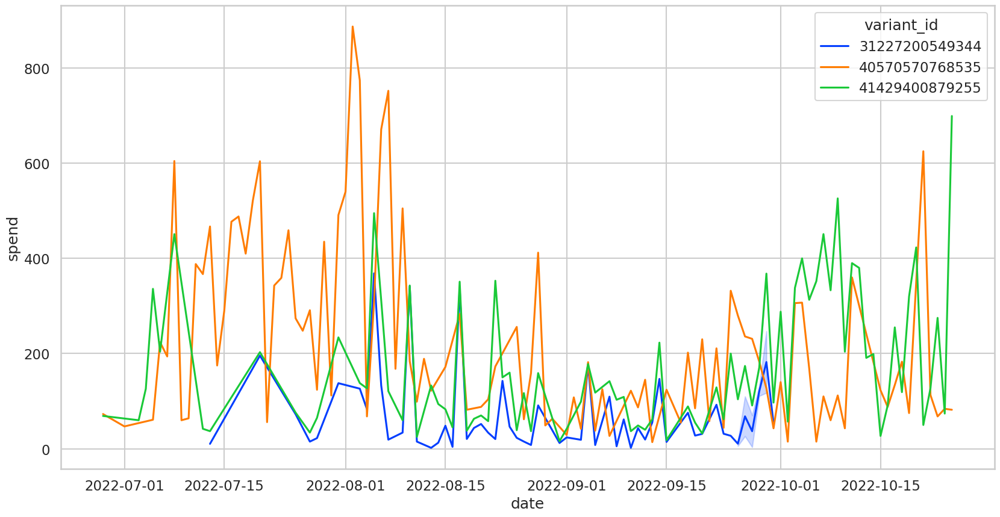

In [141]:
# prepare line plot for spend and impressions_1_days_lag for each variant_id with clear distinct color
sns.set_style('whitegrid')
sns.set_context('talk')
sns.set_palette('dark')
plt.figure(figsize=(20,10))
sns.lineplot(data=agg_data_feature,x='date',y='spend',hue='variant_id',palette='bright')


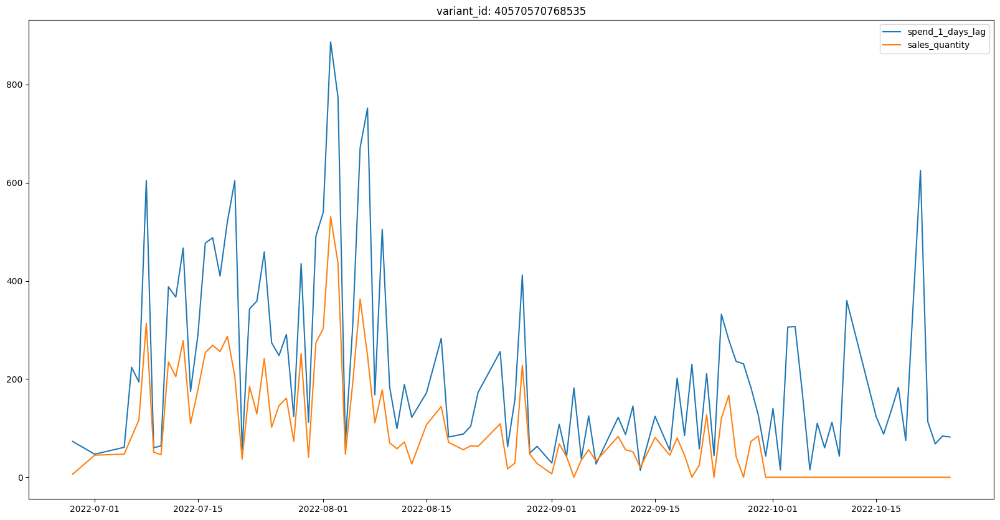

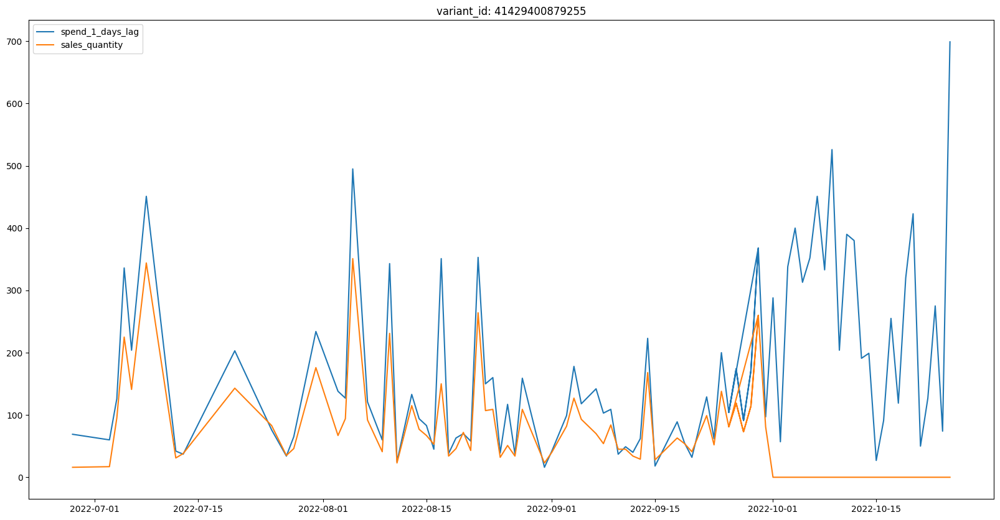

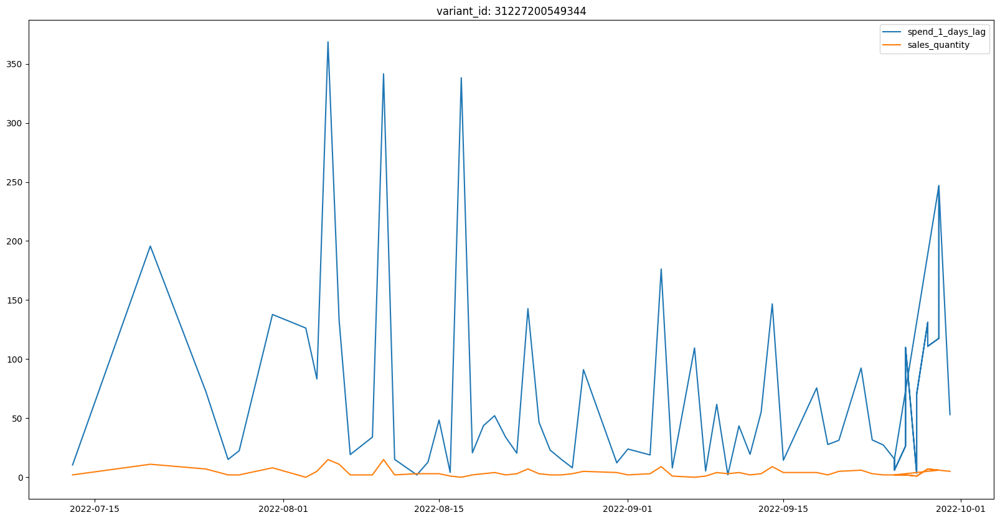

In [24]:
# create plot for each variant_id with spend and sales_quantity to check the relationship between lagged spend(as example spend_1_days_lag) and sales_quantity. 
#make 3 plots each for each variant_id and overlay spend and sales_quantity and show legend for sales and spend for each plot
variants = agg_data_feature['variant_id'].unique()
for variant in variants:
    plt.figure(figsize=(20,10))
    plt.plot(agg_data_feature[agg_data_feature['variant_id']==variant]['date'],agg_data_feature[agg_data_feature['variant_id']==variant]['spend_1_days_lag'])
    plt.plot(agg_data_feature[agg_data_feature['variant_id']==variant]['date'],agg_data_feature[agg_data_feature['variant_id']==variant]['sales_quantity'])
    plt.legend(['spend_1_days_lag','sales_quantity'])
    plt.title('variant_id: '+str(variant))
    plt.show()


In [25]:
ProfileReport(agg_data_feature.drop(['campaign_id','variant_id'],axis=1),title='EDA report for agg_data_feature',explorative=True,progress_bar=False)

##### 1) After initially analysing the data, what did you find out? Is there anything weird / strange that could be improved?

- the campaign data is available only from 2022-06-28 onwards, so we can not use the sales data before 2022-06-28 to capture campaign effect.

- while the campaign spend and sales capture a pattern for 40570570768535, 41429400879255 for 31227200549344 there is little impact of campaign on sales.

- the sales is stongly correlate with its week_of_year,day_of_year lagged values and mederately correlated with price, discount, oil price and the lagged campaign spend and impression.

- We may expect seasonality, trend in sales.

- naturally the spend is correlated with lagged impressions.

- To improve the we may capture more campaign days to build more robust model and make the sales dat for each variant_id available throughout the time period.

- Also to optimize the spending for 31227200549344

2. What cleaning steps did you consider, which did you implement and why?
- lack of hmogeniuty in the time series data(while 40570570768535 and 41429400879255 are avilable throughout the time period, 31227200549344 is available only from 2022-07-13-2022-09-30).so to build a global model(to capture the interactivity) we need to use the data from 2022-07-13. 

3. What have you learned about the data and the problem until now, that helped you in
coming up with further valuable features?
- As I data doesn't have the market information, I havn't use the weather data, however with this information we can build a more accurate model for sunglass sales forcast.
- Also the effective data period is from 2022-07-13-2022-09-30, mostly homogenious climate(summer).


4. Are there other advanced feature engineering approaches / methods you would try to
improve accuracy if having more time?

- Other raw materials(plastic, glass) price index.
- Distribution channel information and costs
- Geographical information
- consumer & macroeconomic demographic information('consumer_price_index','real_income',
       'working_age_population', 'unemployment_rate' etc.)


In [16]:
from darts import TimeSeries
from darts.utils.timeseries_generation import gaussian_timeseries, linear_timeseries, sine_timeseries
from darts.models import LightGBMModel, CatBoostModel, Prophet, RNNModel, TFTModel, NaiveSeasonal, ExponentialSmoothing, NHiTSModel
import torch
# %pip install torch torchvision torchaudio
# %pip install cudatoolkit=11.8 -c pytorch -c nvidia

### Task #3: Forecast sales

##### 1) What model did you choose and why?

- As the data size is small, I have used the classical ML model using CatBoost and covert time series data to regression problem to predict the sales.
- Also as the no of unique product is 3, I will build a global time series model to capture interactivity amonst the products.

In [62]:
#replace 0 in price column with max price for that variant_id and repla

#create seperate dataframes

sales = agg_data[['date','variant_id','sales_quantity','selling_price']][(agg_data['date']>='2022-07-13') & (agg_data['date']<='2022-09-30')]
sales['selling_price'] = sales.groupby('variant_id')['selling_price'].transform(lambda x: x.replace(0,x.max()))
campaign = agg_data[['date','variant_id','impressions','spend']][(agg_data['date']>='2022-07-13') & (agg_data['date']<='2022-09-30')]
campaign = campaign.drop_duplicates(subset=['date','variant_id'])
discount = agg_data[['date','variant_id','avg_discount']][(agg_data['date']>='2022-07-13') & (agg_data['date']<='2022-09-30')] 
df_oil_price = df_oil_price[(df_oil_price['Date']>='2022-07-13') & (df_oil_price['Date']<='2022-09-30')]

In [135]:
#sales-quantity time series

from darts import TimeSeries
import numpy as np
variant_list = sales['variant_id'].unique()
variant_TS_dict = {}

# for variant in variant_list:
#   df_family = train.loc[train['variant_id'] == variant]
family_TS_dict = {}
for variant in variant_list:
  # print(variant)
  df_family = sales.loc[sales['variant_id'] == variant].drop_duplicates()
  list_of_TS_family = TimeSeries.from_group_dataframe(
                                df_family,
                                time_col="date",
                                group_cols=["variant_id"],  # individual time series are extracted by grouping `df` by `group_cols`
                                static_cols=['selling_price'], # also extract these additional columns as static covariates
                                value_cols="sales_quantity", # target variable
                                fill_missing_dates=True,fillna_value=0, freq='D')
  
  for ts in list_of_TS_family:
    ts = ts.astype(np.float32)

  list_of_TS_family = sorted(list_of_TS_family, key=lambda ts: int(ts.static_covariates_values()[0,0]))
  family_TS_dict[variant] = list_of_TS_family

#transform and scale the data
from darts.dataprocessing.transformers import Scaler
# Transform the Sales Data
from darts.dataprocessing.transformers import MissingValuesFiller, InvertibleMapper, Mapper,StaticCovariatesTransformer
import sklearn
from darts.dataprocessing import Pipeline

family_pipeline_dict = {}
family_TS_transformed_dict = {}
for key in family_TS_dict:
  train_filler = MissingValuesFiller(verbose=False, n_jobs=-1, name="Fill NAs")
  static_cov_transformer = StaticCovariatesTransformer(verbose=False, transformer_cat = sklearn.preprocessing.OneHotEncoder(), name="Encoder") #OneHotEncoder would be better but takes longer
  log_transformer = InvertibleMapper(np.log1p, np.expm1, verbose=False, n_jobs=-1, name="Log-Transform")   
  train_scaler = Scaler(verbose=False, n_jobs=-1, name="Scaling")
  train_pipeline = Pipeline([train_filler,
                             static_cov_transformer,
                             log_transformer,
                             train_scaler])
     
  training_transformed = train_pipeline.fit_transform(family_TS_dict[key])
  family_pipeline_dict[key] = train_pipeline
  family_TS_transformed_dict[key] = training_transformed 

# Create TimeSeries objects (Darts)
list_of_TS = TimeSeries.from_group_dataframe(
                                sales.drop_duplicates(),
                                time_col="date",
                                group_cols=["variant_id"],  # individual time series are extracted by grouping `df` by `group_cols`
                                static_cols=["selling_price"], # also extract these additional columns as static covariates
                                value_cols="sales_quantity", # target variable
                                fill_missing_dates=True,fillna_value=0,
                                freq='D')
for ts in list_of_TS:
  ts = ts.astype(np.float32)
list_of_TS = sorted(list_of_TS, key=lambda ts: int(ts.static_covariates_values()[0,0])) 

# Transform the Sales Data
train_filler = MissingValuesFiller(verbose=False, n_jobs=-1, name="Fill NAs")
static_cov_transformer = StaticCovariatesTransformer(verbose=False, transformer_cat = sklearn.preprocessing.OneHotEncoder(), name="Encoder") #OneHotEncoder would be better but takes longer
log_transformer = InvertibleMapper(np.log1p, np.expm1, verbose=False, n_jobs=-1, name="Log-Transform")   
train_scaler = Scaler(verbose=False, n_jobs=-1, name="Scaling")

train_pipeline = Pipeline([train_filler,
                             static_cov_transformer,
                             log_transformer,
                             train_scaler])
     
training_transformed = train_pipeline.fit_transform(list_of_TS)

In [64]:
# Create 7-day and 28-day moving average of sales

from darts.models import MovingAverageFilter
sales_moving_average_3 = MovingAverageFilter(window=3)
sales_moving_average_7 = MovingAverageFilter(window=7)

sales_moving_averages_dict = {}

for key in family_TS_transformed_dict:
  sales_mas_family = []
  
  for ts in family_TS_transformed_dict[key]:
    ma_7 = sales_moving_average_7.filter(ts)
    ma_7 = TimeSeries.from_series(ma_7.pd_series())  
    ma_7 = ma_7.astype(np.float32)
    ma_7 = ma_7.with_columns_renamed(col_names=ma_7.components, col_names_new="sales_ma_7")
    ma_3 = sales_moving_average_3.filter(ts)
    ma_3 = TimeSeries.from_series(ma_3.pd_series())  
    ma_3 = ma_3.astype(np.float32)
    ma_3 = ma_3.with_columns_renamed(col_names=ma_3.components, col_names_new="sales_ma_3")
    mas = ma_7.stack(ma_3)
    sales_mas_family.append(mas)
  
  sales_moving_averages_dict[key] = sales_mas_family

/home/sourish/.local/lib/python3.10/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: '/home/sourish/.local/lib/python3.10/site-packages/torchvision/image.so: undefined symbol: _ZNK3c107SymBool10guard_boolEPKcl'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(


In [65]:
#campaign performance - spend

for variant in variant_list:
  df_family = campaign.loc[sales['variant_id'] == variant].drop_duplicates()
  list_of_TS_family = TimeSeries.from_group_dataframe(
                                df_family,
                                time_col="date",
                                group_cols=["variant_id"],  # individual time series are extracted by grouping `df` by `group_cols`
                                value_cols="spend", # target variable
                                fill_missing_dates=True, freq='D')
  
  for ts in list_of_TS_family:
    ts = ts.astype(np.float32)

  family_TS_dict[variant] = list_of_TS_family

campaign_spend_pipeline_dict = {}
spend_transformed_dict = {}
for key in family_TS_dict:
  campaign_pipeline = Pipeline([train_filler,
                             train_scaler])
     
  campaign_spend_transformed = campaign_pipeline.fit_transform(family_TS_dict[key])
  campaign_spend_pipeline_dict[key] = campaign_pipeline
  spend_transformed_dict[key] = campaign_spend_transformed 

sales_moving_average_2 = MovingAverageFilter(window=2)
spend_moving_averages_dict = {}

for key in spend_transformed_dict:
  spend_mas_family = []
  
  for ts in spend_transformed_dict[key]:
    ma_7 = sales_moving_average_7.filter(ts)
    ma_7 = TimeSeries.from_series(ma_7.pd_series())  
    ma_7 = ma_7.astype(np.float32)
    ma_7 = ma_7.with_columns_renamed(col_names=ma_7.components, col_names_new="spend_ma_7")
    ma_3 = sales_moving_average_3.filter(ts)
    ma_3 = TimeSeries.from_series(ma_3.pd_series())  
    ma_3 = ma_3.astype(np.float32)
    ma_3 = ma_3.with_columns_renamed(col_names=ma_3.components, col_names_new="spend_ma_3")
    ma_2 = sales_moving_average_2.filter(ts)
    ma_2 = TimeSeries.from_series(ma_2.pd_series())  
    ma_2 = ma_2.astype(np.float32)
    ma_2 = ma_2.with_columns_renamed(col_names=ma_2.components, col_names_new="spend_ma_2")
    mas = ma_7.stack(ma_3).stack(ma_2)
    spend_mas_family.append(mas)
  
  spend_moving_averages_dict[key] = spend_mas_family

#campaign performance - impressions

for variant in variant_list:
  df_family = campaign.loc[sales['variant_id'] == variant].drop_duplicates()
  list_of_TS_family = TimeSeries.from_group_dataframe(
                                df_family,
                                time_col="date",
                                group_cols=["variant_id"],  # individual time series are extracted by grouping `df` by `group_cols`
                                value_cols="impressions", # target variable
                                fill_missing_dates=True, freq='D')
  
  for ts in list_of_TS_family:
    ts = ts.astype(np.float32)

  family_TS_dict[variant] = list_of_TS_family

campaign_impressions_pipeline_dict = {}
impressions_transformed_dict = {}
for key in family_TS_dict:
  campaign_impressions_transformed = campaign_pipeline.fit_transform(family_TS_dict[key])
  campaign_impressions_pipeline_dict[key] = campaign_pipeline
  impressions_transformed_dict[key] = campaign_impressions_transformed 

impressions_moving_averages_dict = {}

for key in impressions_transformed_dict:
  impressions_mas_family = []
  
  for ts in impressions_transformed_dict[key]:
    ma_7 = sales_moving_average_7.filter(ts)
    ma_7 = TimeSeries.from_series(ma_7.pd_series())  
    ma_7 = ma_7.astype(np.float32)
    ma_7 = ma_7.with_columns_renamed(col_names=ma_7.components, col_names_new="impression_ma_7")
    ma_3 = sales_moving_average_3.filter(ts)
    ma_3 = TimeSeries.from_series(ma_3.pd_series())  
    ma_3 = ma_3.astype(np.float32)
    ma_3 = ma_3.with_columns_renamed(col_names=ma_3.components, col_names_new="impression_ma_3")
    ma_2 = sales_moving_average_2.filter(ts)
    ma_2 = TimeSeries.from_series(ma_2.pd_series())  
    ma_2 = ma_2.astype(np.float32)
    ma_2 = ma_2.with_columns_renamed(col_names=ma_2.components, col_names_new="impression_ma_2")
    mas = ma_7.stack(ma_3).stack(ma_2)
    impressions_mas_family.append(mas)
  
  impressions_moving_averages_dict[key] = impressions_mas_family  

In [66]:
#Discounts

for variant in variant_list:
  df_family = discount.loc[sales['variant_id'] == variant].drop_duplicates()
  list_of_TS_family = TimeSeries.from_group_dataframe(
                                df_family,
                                time_col="date",
                                group_cols=["variant_id"],  # individual time series are extracted by grouping `df` by `group_cols`
                                value_cols="avg_discount", # target variable
                                fill_missing_dates=True, freq='D')
  
  for ts in list_of_TS_family:
    ts = ts.astype(np.float32)

  family_TS_dict[variant] = list_of_TS_family

discount_pipeline_dict = {}
discount_transformed_dict = {}
for key in family_TS_dict:
  discount_pipeline = Pipeline([train_filler])
  discount_transformed = discount_pipeline.fit_transform(family_TS_dict[key])
  discount_pipeline_dict[key] = discount_pipeline
  discount_transformed_dict[key] = discount_transformed 

discount_moving_averages_dict = {}

for key in discount_transformed_dict:
  discount_mas_family = []
  
  for ts in discount_transformed_dict[key]:
    ma_7 = sales_moving_average_7.filter(ts)
    ma_7 = TimeSeries.from_series(ma_7.pd_series())  
    ma_7 = ma_7.astype(np.float32)
    ma_7 = ma_7.with_columns_renamed(col_names=ma_7.components, col_names_new="discount_ma_7")
    ma_3 = sales_moving_average_3.filter(ts)
    ma_3 = TimeSeries.from_series(ma_3.pd_series())  
    ma_3 = ma_3.astype(np.float32)
    ma_3 = ma_3.with_columns_renamed(col_names=ma_3.components, col_names_new="discount_ma_3")
    mas = ma_7.stack(ma_3)
    discount_mas_family.append(mas)
  
  discount_moving_averages_dict[key] = discount_mas_family  

In [67]:
# General Covariates (Time-Based and Oil)
from darts.utils.timeseries_generation import datetime_attribute_timeseries
full_time_period = pd.date_range(start='2022-07-13', end='2022-09-30', freq='D')

# Time-Based Covariates

month = datetime_attribute_timeseries(time_index = full_time_period, attribute="month")
day = datetime_attribute_timeseries(time_index = full_time_period, attribute="day")
dayofyear = datetime_attribute_timeseries(time_index = full_time_period, attribute="dayofyear")
weekday = datetime_attribute_timeseries(time_index = full_time_period, attribute="dayofweek")
weekofyear = datetime_attribute_timeseries(time_index = full_time_period, attribute="weekofyear")
timesteps = TimeSeries.from_times_and_values(times=full_time_period,
                                             values=np.arange(len(full_time_period)),
                                             columns=["linear_increase"])

time_cov = month.stack(day).stack(dayofyear).stack(weekday).stack(weekofyear).stack(timesteps)
time_cov = time_cov.astype(np.float32)

# Transform
time_cov_scaler = Scaler(verbose=False, n_jobs=-1, name="Scaler")
time_cov_train, time_cov_val = time_cov.split_before(pd.Timestamp('20220916'))
time_cov_scaler.fit(time_cov_train)
time_cov_transformed = time_cov_scaler.transform(time_cov)

# Oil Price

oil = TimeSeries.from_dataframe(df_oil_price, 
                                time_col = 'Date', 
                                value_cols = ['Price'],
                                freq = 'D')
oil = oil.astype(np.float32)

# Transform
oil_filler = MissingValuesFiller(verbose=False, n_jobs=-1, name="Filler")
oil_scaler = Scaler(verbose=False, n_jobs=-1, name="Scaler")
oil_pipeline = Pipeline([oil_filler, oil_scaler])
oil_transformed = oil_pipeline.fit_transform(oil)

# Moving Averages for Oil Price
oil_moving_average_7 = MovingAverageFilter(window=7)
oil_moving_average_15 = MovingAverageFilter(window=15)

oil_moving_averages = []

ma_7 = oil_moving_average_7.filter(oil_transformed).astype(np.float32)
ma_7 = ma_7.with_columns_renamed(col_names=ma_7.components, col_names_new="oil_ma_7")
ma_15 = oil_moving_average_15.filter(oil_transformed).astype(np.float32)
ma_15 = ma_15.with_columns_renamed(col_names=ma_15.components, col_names_new="oil_ma_15")
oil_moving_averages = ma_7.stack(ma_15)

# Stack General Covariates Together

general_covariates = time_cov_transformed.stack(oil_transformed).stack(oil_moving_averages)
general_covariates

<TimeSeries (DataArray) (time: 80, component: 9, sample: 1)>
array([[[0.        ],
        [0.40000004],
        [0.        ],
        [0.33333334],
        [0.        ],
        [0.        ],
        [0.7091012 ],
        [0.7985311 ],
        [0.8798603 ]],

       [[0.        ],
        [0.43333337],
        [0.015625  ],
        [0.5       ],
        [0.        ],
        [0.015625  ],
        [0.72551847],
        [0.8292051 ],
        [0.87893623]],

...

       [[1.        ],
        [0.93333334],
        [1.21875   ],
        [0.5       ],
        [1.2222223 ],
        [1.21875   ],
        [0.19758058],
        [0.13611746],
        [0.11187911]],

       [[1.        ],
        [0.96666664],
        [1.234375  ],
        [0.6666667 ],
        [1.2222223 ],
        [1.234375  ],
        [0.1828916 ],
        [0.17014682],
        [0.09760219]]], dtype=float32)
Coordinates:
  * time       (time) datetime64[ns] 2022-07-13 2022-07-14 ... 2022-09-30
  * component  (component) object 'month' 'day' ... 'oil_ma_7' 'oil_ma_15'
Dimensions without coordinates: sample
Attributes:
    static_covariates:  None
    hierarchy:          None

In [108]:
#test-validation split

val_len = 15

train = [s[: -(1 * val_len)] for s in training_transformed]
val = [s[-val_len:] for s in training_transformed]

In [69]:
# 2.5. Assemble All Covariates in Dictionaries

future_covariates_dict = {}

for variant in variant_list:
  stacked_covariates = impressions_moving_averages_dict[variant][0].stack(spend_moving_averages_dict[variant][0]).stack(discount_moving_averages_dict[variant][0]).stack(general_covariates)  
  future_covariates_dict[variant] = stacked_covariates
from tqdm import tqdm
past_covariates_dict = {}

for key in tqdm(discount_moving_averages_dict):

  promotion_family = discount_moving_averages_dict[key]
  sales_mas = sales_moving_averages_dict[key]
  covariates_past = [promotion_family[i].stack(sales_mas[i]) for i in range(0,len(promotion_family))]

  past_covariates_dict[key] = covariates_past

only_past_covariates_dict = {}

for key in tqdm(sales_moving_averages_dict):
  sales_moving_averages = sales_moving_averages_dict[key]
  impression = impressions_moving_averages_dict[key]
  spend = spend_moving_averages_dict[key]
  only_past_covariates = [sales_moving_averages[i].stack(impression[i]).stack(spend[i]) for i in range(0,len(sales_moving_averages))]

  only_past_covariates_dict[key] = only_past_covariates  

100%|██████████| 3/3 [00:00<00:00, 243.86it/s]


In [73]:
#processing for Global CatBoost model

def flatten(l):
  return [item for sublist in l for item in sublist]

future_covariates_full = []

for variant in variant_list:
  future_covariates_full.append(future_covariates_dict[variant])
    
# future_covariates_full = flatten(future_covariates_full)

only_past_covariates_full = []

for variant in variant_list:
  only_past_covariates_full.append(only_past_covariates_dict[variant])
    
only_past_covariates_full = flatten(only_past_covariates_full)


only_past_covariates_shifted = []

for ts in only_past_covariates_full:
  shifted = ts.shift(n=15)
  only_past_covariates_shifted.append(shifted)


In [180]:
from darts.models import CatBoostModel,LightGBMModel
import torch

def build_fit_cboost_model(
    lags,out_len,
    firstlag,
    pastcovlag,
    learning_rate,depth,
    val=True
    ):

    # reproducibility
    torch.manual_seed(42)

    # some fixed parameters that will be the same for all models
    MAX_SAMPLES_PER_TS = 25

    model = CatBoostModel(lags = lags,
                      lags_future_covariates = (firstlag,1),
                             lags_past_covariates = [pastcovlag], 
                             output_chunk_length=out_len,
                          learning_rate=learning_rate,
                          depth=depth,
                             early_stopping_rounds=10,
                             random_state=2022,
                          logging_level='Silent'
                          )

    # when validating during training, we can use a slightly longer validation

    model_val_set = [s[-((1 * val_len) + lags) : -val_len] for s in training_transformed]

    # train the model
    if val:
      model.fit(series=training_transformed,past_covariates=only_past_covariates_shifted,val_past_covariates=only_past_covariates_shifted,max_samples_per_ts=MAX_SAMPLES_PER_TS,future_covariates=future_covariates_full,val_future_covariates=future_covariates_full)
    else:
      model.fit(series=training_transformed,past_covariates=only_past_covariates_shifted,max_samples_per_ts=MAX_SAMPLES_PER_TS)
    return model

In [138]:
#training & evaluation
catboost_params = {'lags': 7, 
                   'out_len': 3, 
                   'firstlag': 5, 
                   'pastcovlag': -7, 
                   'learning_rate': 0.06, 
                   'depth': 4}
model = build_fit_cboost_model(catboost_params['lags'],catboost_params['out_len'],catboost_params['firstlag'],catboost_params['pastcovlag'],catboost_params['learning_rate'],catboost_params['depth'])

pred = model.predict(series=train,n=15,future_covariates=future_covariates_full,past_covariates=only_past_covariates_shifted)
forecasts_back = train_pipeline.inverse_transform(pred, partial=True)

# Mean RMSLE
from darts.metrics import mape, smape, rmse, rmsle
CatBoost_rmsle = rmsle(actual_series = list_of_TS,
                 pred_series = forecasts_back,
                 n_jobs = -1,
                 inter_reduction=np.mean)

CatBoost_smape = smape(actual_series = list_of_TS,
                 pred_series = forecasts_back,
                 n_jobs = -1,
                 inter_reduction=np.mean)

print("\n")
print("The mean RMSLE for the Global CatBoost Model over 1782 series is {:.5f}.".format(CatBoost_rmsle))
# print("The mean MAPE for the Global CatBoost Model over 1782 series is {:.5f}.".format(CatBoost_mape))
print("The mean SMAPE for the Global CatBoost Model over 1782 series is {:.5f}.".format(CatBoost_smape))
print("\n")



The mean RMSLE for the Global CatBoost Model over 1782 series is 0.00012.
The mean SMAPE for the Global CatBoost Model over 1782 series is 48.89625.




#### Forecast 2022-10-01 to 2023-12-01 

In [186]:

## training on full data and forecast for 2 weeks and prepare a csv with column names for variants and dates as index from 2022-10-01 to 2022-10-15

catboost_params = {'lags': 7, 
                   'out_len': 3, 
                   'firstlag': 5, 
                   'pastcovlag': -60, 
                   'learning_rate': 0.06, 
                   'depth': 4}
model = build_fit_cboost_model(catboost_params['lags'],catboost_params['out_len'],catboost_params['firstlag'],catboost_params['pastcovlag'],catboost_params['learning_rate'],catboost_params['depth'],val=False)

pred = model.predict(series=training_transformed,n=60,past_covariates=only_past_covariates_shifted)
forecasts_back = train_pipeline.inverse_transform(pred, partial=True)

#convert to dataframe
forecast_df = pd.DataFrame(columns=['31227200549344','40570570768535','41429400879255'])
for i,col in enumerate(forecast_df.columns):
  forecast_df[col] = forecasts_back[i].pd_series()

forecast_df = forecast_df.reset_index().rename(columns={'index':'date'})
display(forecast_df.head())
forecast_df.to_csv('forecast.csv',index=False)


,date,31227200549344,40570570768535,41429400879255
0,2022-10-01,2.683827,28.351572,47.603692
1,2022-10-02,2.405229,98.306936,80.154503
2,2022-10-03,5.781406,17.306243,69.126157
3,2022-10-04,2.408451,11.556556,31.454396
4,2022-10-05,3.544976,73.292219,39.350208


1) Which deep learning model did you consider and why?
- I have not used any deep learning model as the data size is small and the classical ML model is performing better than DL.However I tried TCN,TFT and NHits with worse evaluation metrics.

2) Which features are relevant for forecasting? Can some be removed?
- impressions, spend and discount. However impressions may not available on the same day, so we may not use it to predict the sales.

3) Does your engineered feature really improve the accuracy of the deep learning model?
- Yes, the engineered features are improving the accuracy of the model.

4) Is the accuracy going to change with more data and compute resources being available
for training?
- Yes, because of the tiny data size for each Series advanced DL models are not performing well.may be with more training data the accuracy will improve.For this data compute resource is not a bottleneck.

In [187]:
!pip freeze > requirements.txt